<a href="https://colab.research.google.com/github/shreyadas-maple/BIL_Project_work/blob/master/LGBMClassifier_AB_NO_SMOTE_(Classification)_F_195_No_data_split.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install Optuna for hyperparameter optimization of the models that we might want to train

%pip install optuna

In [ ]:

import os
import numpy as np
import pandas as pd
from typing import List, Optional

from google.auth import default

# ML
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import roc_auc_score, classification_report
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE

import xgboost as xgb
import optuna
import shap
import matplotlib.pyplot as plt

# Optional: nicer printing
pd.set_option("display.max_columns", 200)
pd.set_option("display.width", 200)



In [ ]:
# 2) Read-in the csv for the dataset
df = pd.read_csv("./ADNI_PET_AB_EPVS_DTI_ALPS_T1_aparc_aseg_ravens_contrast_EXTRA_TIV_Norm_FW.csv")

# If we want to filter out the tracers from the dataset
FILTER_TRACER = None

SEED = 13

df.shape

# Z-Score or StandardScaler could improve the accuracy
# save the mean and SD for reporting -> both must be the same between testing and training

(394, 584)

In [ ]:
features_df = pd.read_csv("./F_195.csv")
display(features_df.head())

,CENTILOIDS_AB_tx,AGE_Actual,PTGENDER,lh_bankssts_volume,lh_caudalanteriorcingulate_volume,lh_caudalmiddlefrontal_volume,lh_cuneus_volume,lh_entorhinal_volume,lh_fusiform_volume,lh_inferiorparietal_volume,lh_inferiortemporal_volume,lh_isthmuscingulate_volume,lh_lateraloccipital_volume,lh_lateralorbitofrontal_volume,lh_lingual_volume,lh_medialorbitofrontal_volume,lh_middletemporal_volume,lh_parahippocampal_volume,lh_paracentral_volume,lh_parsopercularis_volume,lh_parsorbitalis_volume,lh_parstriangularis_volume,lh_pericalcarine_volume,lh_postcentral_volume,lh_posteriorcingulate_volume,lh_precentral_volume,lh_precuneus_volume,lh_rostralanteriorcingulate_volume,lh_rostralmiddlefrontal_volume,lh_superiorfrontal_volume,lh_superiorparietal_volume,lh_superiortemporal_volume,lh_supramarginal_volume,lh_frontalpole_volume,lh_temporalpole_volume,lh_transversetemporal_volume,lh_insula_volume,rh_bankssts_volume,rh_caudalanteriorcingulate_volume,rh_caudalmiddlefrontal_volume,rh_cuneus_volume,rh_entorhinal_volume,rh_fusiform_volume,rh_inferiorparietal_volume,rh_inferiortemporal_volume,rh_isthmuscingulate_volume,rh_lateraloccipital_volume,rh_lateralorbitofrontal_volume,rh_lingual_volume,rh_medialorbitofrontal_volume,rh_middletemporal_volume,rh_parahippocampal_volume,rh_paracentral_volume,rh_parsopercularis_volume,rh_parsorbitalis_volume,rh_parstriangularis_volume,rh_pericalcarine_volume,rh_postcentral_volume,rh_posteriorcingulate_volume,rh_precentral_volume,rh_precuneus_volume,rh_rostralanteriorcingulate_volume,rh_rostralmiddlefrontal_volume,rh_superiorfrontal_volume,rh_superiorparietal_volume,rh_superiortemporal_volume,rh_supramarginal_volume,rh_frontalpole_volume,rh_temporalpole_volume,rh_transversetemporal_volume,rh_insula_volume,Left.Lateral.Ventricle,Left.Inf.Lat.Vent,Left.Cerebellum.White.Matter,Left.Cerebellum.Cortex,Left.Thalamus,Left.Caudate,Left.Putamen,Left.Pallidum,X3rd.Ventricle,X4th.Ventricle,Brain.Stem,Left.Hippocampus,Left.Amygdala,Left.Accumbens.area,Left.choroid.plexus,Right.Lateral.Ventricle,Right.Inf.Lat.Vent,Right.Cerebellum.White.Matter,Right.Cerebellum.Cortex,Right.Thalamus,Right.Caudate,Right.Putamen,Right.Pallidum,Right.Hippocampus,Right.Amygdala,Right.Accumbens.area,Right.choroid.plexus,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,lhCortexVol,rhCortexVol,lhCerebralWhiteMatterVol,rhCerebralWhiteMatterVol,SubCortGrayVol,TotalGrayVol,SupraTentorialVol,lh_bankssts_thickness,lh_caudalanteriorcingulate_thickness,lh_caudalmiddlefrontal_thickness,lh_cuneus_thickness,lh_entorhinal_thickness,lh_fusiform_thickness,lh_inferiorparietal_thickness,lh_inferiortemporal_thickness,lh_isthmuscingulate_thickness,lh_lateraloccipital_thickness,lh_lateralorbitofrontal_thickness,lh_lingual_thickness,lh_medialorbitofrontal_thickness,lh_middletemporal_thickness,lh_parahippocampal_thickness,lh_paracentral_thickness,lh_parsopercularis_thickness,lh_parsorbitalis_thickness,lh_parstriangularis_thickness,lh_pericalcarine_thickness,lh_postcentral_thickness,lh_posteriorcingulate_thickness,lh_precentral_thickness,lh_precuneus_thickness,lh_rostralanteriorcingulate_thickness,lh_rostralmiddlefrontal_thickness,lh_superiorfrontal_thickness,lh_superiorparietal_thickness,lh_superiortemporal_thickness,lh_supramarginal_thickness,lh_frontalpole_thickness,lh_temporalpole_thickness,lh_transversetemporal_thickness,lh_insula_thickness,rh_bankssts_thickness,rh_caudalanteriorcingulate_thickness,rh_caudalmiddlefrontal_thickness,rh_cuneus_thickness,rh_entorhinal_thickness,rh_fusiform_thickness,rh_inferiorparietal_thickness,rh_inferiortemporal_thickness,rh_isthmuscingulate_thickness,rh_lateraloccipital_thickness,rh_lateralorbitofrontal_thickness,rh_lingual_thickness,rh_medialorbitofrontal_thickness,rh_middletemporal_thickness,rh_parahippocampal_thickness,rh_paracentral_thickness,rh_parsopercularis_thickness,rh_parsorbitalis_thickness,rh_parstriangularis_thickness,rh_pericalcarine_thickness,rh_postcentral_thickness,rh_posteriorcingulate_thickness,rh

In [ ]:
features_df.shape

(0, 183)

In [ ]:
# Load the feature names from the CSV file
feature_names = pd.read_csv("./F_195.csv", header=None).iloc[0].tolist()

# Select the features from the main DataFrame
df_features_selected = df[feature_names]

display(df_features_selected.head())

,CENTILOIDS_AB_tx,AGE_Actual,PTGENDER,lh_bankssts_volume,lh_caudalanteriorcingulate_volume,lh_caudalmiddlefrontal_volume,lh_cuneus_volume,lh_entorhinal_volume,lh_fusiform_volume,lh_inferiorparietal_volume,lh_inferiortemporal_volume,lh_isthmuscingulate_volume,lh_lateraloccipital_volume,lh_lateralorbitofrontal_volume,lh_lingual_volume,lh_medialorbitofrontal_volume,lh_middletemporal_volume,lh_parahippocampal_volume,lh_paracentral_volume,lh_parsopercularis_volume,lh_parsorbitalis_volume,lh_parstriangularis_volume,lh_pericalcarine_volume,lh_postcentral_volume,lh_posteriorcingulate_volume,lh_precentral_volume,lh_precuneus_volume,lh_rostralanteriorcingulate_volume,lh_rostralmiddlefrontal_volume,lh_superiorfrontal_volume,lh_superiorparietal_volume,lh_superiortemporal_volume,lh_supramarginal_volume,lh_frontalpole_volume,lh_temporalpole_volume,lh_transversetemporal_volume,lh_insula_volume,rh_bankssts_volume,rh_caudalanteriorcingulate_volume,rh_caudalmiddlefrontal_volume,rh_cuneus_volume,rh_entorhinal_volume,rh_fusiform_volume,rh_inferiorparietal_volume,rh_inferiortemporal_volume,rh_isthmuscingulate_volume,rh_lateraloccipital_volume,rh_lateralorbitofrontal_volume,rh_lingual_volume,rh_medialorbitofrontal_volume,rh_middletemporal_volume,rh_parahippocampal_volume,rh_paracentral_volume,rh_parsopercularis_volume,rh_parsorbitalis_volume,rh_parstriangularis_volume,rh_pericalcarine_volume,rh_postcentral_volume,rh_posteriorcingulate_volume,rh_precentral_volume,rh_precuneus_volume,rh_rostralanteriorcingulate_volume,rh_rostralmiddlefrontal_volume,rh_superiorfrontal_volume,rh_superiorparietal_volume,rh_superiortemporal_volume,rh_supramarginal_volume,rh_frontalpole_volume,rh_temporalpole_volume,rh_transversetemporal_volume,rh_insula_volume,Left.Lateral.Ventricle,Left.Inf.Lat.Vent,Left.Cerebellum.White.Matter,Left.Cerebellum.Cortex,Left.Thalamus,Left.Caudate,Left.Putamen,Left.Pallidum,X3rd.Ventricle,X4th.Ventricle,Brain.Stem,Left.Hippocampus,Left.Amygdala,Left.Accumbens.area,Left.choroid.plexus,Right.Lateral.Ventricle,Right.Inf.Lat.Vent,Right.Cerebellum.White.Matter,Right.Cerebellum.Cortex,Right.Thalamus,Right.Caudate,Right.Putamen,Right.Pallidum,Right.Hippocampus,Right.Amygdala,Right.Accumbens.area,Right.choroid.plexus,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,lhCortexVol,rhCortexVol,lhCerebralWhiteMatterVol,rhCerebralWhiteMatterVol,SubCortGrayVol,TotalGrayVol,SupraTentorialVol,lh_bankssts_thickness,lh_caudalanteriorcingulate_thickness,lh_caudalmiddlefrontal_thickness,lh_cuneus_thickness,lh_entorhinal_thickness,lh_fusiform_thickness,lh_inferiorparietal_thickness,lh_inferiortemporal_thickness,lh_isthmuscingulate_thickness,lh_lateraloccipital_thickness,lh_lateralorbitofrontal_thickness,lh_lingual_thickness,lh_medialorbitofrontal_thickness,lh_middletemporal_thickness,lh_parahippocampal_thickness,lh_paracentral_thickness,lh_parsopercularis_thickness,lh_parsorbitalis_thickness,lh_parstriangularis_thickness,lh_pericalcarine_thickness,lh_postcentral_thickness,lh_posteriorcingulate_thickness,lh_precentral_thickness,lh_precuneus_thickness,lh_rostralanteriorcingulate_thickness,lh_rostralmiddlefrontal_thickness,lh_superiorfrontal_thickness,lh_superiorparietal_thickness,lh_superiortemporal_thickness,lh_supramarginal_thickness,lh_frontalpole_thickness,lh_temporalpole_thickness,lh_transversetemporal_thickness,lh_insula_thickness,rh_bankssts_thickness,rh_caudalanteriorcingulate_thickness,rh_caudalmiddlefrontal_thickness,rh_cuneus_thickness,rh_entorhinal_thickness,rh_fusiform_thickness,rh_inferiorparietal_thickness,rh_inferiortemporal_thickness,rh_isthmuscingulate_thickness,rh_lateraloccipital_thickness,rh_lateralorbitofrontal_thickness,rh_lingual_thickness,rh_medialorbitofrontal_thickness,rh_middletemporal_thickness,rh_parahippocampal_thickness,rh_paracentral_thickness,rh_parsopercularis_thickness,rh_parsorbitalis_thickness,rh_parstriangularis_thickness,rh_pericalcarine_thickness,rh_postcentral_thickness,rh_posteriorcingulate_thickness,rh

In [ ]:
df['CENTILOIDS_AB_tx_encoded'] = (df['CENTILOIDS_AB_tx'] >= 37).astype(int)
display(df[['CENTILOIDS_AB_tx', 'CENTILOIDS_AB_tx_encoded']].head())

,CENTILOIDS_AB_tx,CENTILOIDS_AB_tx_encoded
0,-22,0
1,-9,0
2,11,0
3,34,0
4,-4,0


In [ ]:
# Load the feature names from the CSV file
feature_names = pd.read_csv("./F_195.csv", header=None).iloc[0].tolist()

# Select the features from the main DataFrame
df_selected_features = df[feature_names]

# Separate features (X) and target (y)
X = df_selected_features.drop(columns=['CENTILOIDS_AB_tx']) # Drop the original, not the encoded column
y = df['CENTILOIDS_AB_tx_encoded']

display(X.head())
display(y.head())

,AGE_Actual,PTGENDER,lh_bankssts_volume,lh_caudalanteriorcingulate_volume,lh_caudalmiddlefrontal_volume,lh_cuneus_volume,lh_entorhinal_volume,lh_fusiform_volume,lh_inferiorparietal_volume,lh_inferiortemporal_volume,lh_isthmuscingulate_volume,lh_lateraloccipital_volume,lh_lateralorbitofrontal_volume,lh_lingual_volume,lh_medialorbitofrontal_volume,lh_middletemporal_volume,lh_parahippocampal_volume,lh_paracentral_volume,lh_parsopercularis_volume,lh_parsorbitalis_volume,lh_parstriangularis_volume,lh_pericalcarine_volume,lh_postcentral_volume,lh_posteriorcingulate_volume,lh_precentral_volume,lh_precuneus_volume,lh_rostralanteriorcingulate_volume,lh_rostralmiddlefrontal_volume,lh_superiorfrontal_volume,lh_superiorparietal_volume,lh_superiortemporal_volume,lh_supramarginal_volume,lh_frontalpole_volume,lh_temporalpole_volume,lh_transversetemporal_volume,lh_insula_volume,rh_bankssts_volume,rh_caudalanteriorcingulate_volume,rh_caudalmiddlefrontal_volume,rh_cuneus_volume,rh_entorhinal_volume,rh_fusiform_volume,rh_inferiorparietal_volume,rh_inferiortemporal_volume,rh_isthmuscingulate_volume,rh_lateraloccipital_volume,rh_lateralorbitofrontal_volume,rh_lingual_volume,rh_medialorbitofrontal_volume,rh_middletemporal_volume,rh_parahippocampal_volume,rh_paracentral_volume,rh_parsopercularis_volume,rh_parsorbitalis_volume,rh_parstriangularis_volume,rh_pericalcarine_volume,rh_postcentral_volume,rh_posteriorcingulate_volume,rh_precentral_volume,rh_precuneus_volume,rh_rostralanteriorcingulate_volume,rh_rostralmiddlefrontal_volume,rh_superiorfrontal_volume,rh_superiorparietal_volume,rh_superiortemporal_volume,rh_supramarginal_volume,rh_frontalpole_volume,rh_temporalpole_volume,rh_transversetemporal_volume,rh_insula_volume,Left.Lateral.Ventricle,Left.Inf.Lat.Vent,Left.Cerebellum.White.Matter,Left.Cerebellum.Cortex,Left.Thalamus,Left.Caudate,Left.Putamen,Left.Pallidum,X3rd.Ventricle,X4th.Ventricle,Brain.Stem,Left.Hippocampus,Left.Amygdala,Left.Accumbens.area,Left.choroid.plexus,Right.Lateral.Ventricle,Right.Inf.Lat.Vent,Right.Cerebellum.White.Matter,Right.Cerebellum.Cortex,Right.Thalamus,Right.Caudate,Right.Putamen,Right.Pallidum,Right.Hippocampus,Right.Amygdala,Right.Accumbens.area,Right.choroid.plexus,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,lhCortexVol,rhCortexVol,lhCerebralWhiteMatterVol,rhCerebralWhiteMatterVol,SubCortGrayVol,TotalGrayVol,SupraTentorialVol,lh_bankssts_thickness,lh_caudalanteriorcingulate_thickness,lh_caudalmiddlefrontal_thickness,lh_cuneus_thickness,lh_entorhinal_thickness,lh_fusiform_thickness,lh_inferiorparietal_thickness,lh_inferiortemporal_thickness,lh_isthmuscingulate_thickness,lh_lateraloccipital_thickness,lh_lateralorbitofrontal_thickness,lh_lingual_thickness,lh_medialorbitofrontal_thickness,lh_middletemporal_thickness,lh_parahippocampal_thickness,lh_paracentral_thickness,lh_parsopercularis_thickness,lh_parsorbitalis_thickness,lh_parstriangularis_thickness,lh_pericalcarine_thickness,lh_postcentral_thickness,lh_posteriorcingulate_thickness,lh_precentral_thickness,lh_precuneus_thickness,lh_rostralanteriorcingulate_thickness,lh_rostralmiddlefrontal_thickness,lh_superiorfrontal_thickness,lh_superiorparietal_thickness,lh_superiortemporal_thickness,lh_supramarginal_thickness,lh_frontalpole_thickness,lh_temporalpole_thickness,lh_transversetemporal_thickness,lh_insula_thickness,rh_bankssts_thickness,rh_caudalanteriorcingulate_thickness,rh_caudalmiddlefrontal_thickness,rh_cuneus_thickness,rh_entorhinal_thickness,rh_fusiform_thickness,rh_inferiorparietal_thickness,rh_inferiortemporal_thickness,rh_isthmuscingulate_thickness,rh_lateraloccipital_thickness,rh_lateralorbitofrontal_thickness,rh_lingual_thickness,rh_medialorbitofrontal_thickness,rh_middletemporal_thickness,rh_parahippocampal_thickness,rh_paracentral_thickness,rh_parsopercularis_thickness,rh_parsorbitalis_thickness,rh_parstriangularis_thickness,rh_pericalcarine_thickness,rh_postcentral_thickness,rh_posteriorcingulate_thickness,rh_precentral_thick

,CENTILOIDS_AB_tx_encoded
0,0
1,0
2,0
3,0
4,0


In [ ]:
# Get the counts for each class in the target variable y
class_counts = y.value_counts()

# Display the class counts
display(class_counts)

,count
CENTILOIDS_AB_tx_encoded,
0,224
1,170


In [ ]:
from sklearn.preprocessing import StandardScaler

# Initialize StandardScaler
scaler = StandardScaler()

# Fit the scaler on the entire dataset and transform it
X_scaled = scaler.fit_transform(X)

# Convert the scaled array back to a DataFrame (optional, but can be helpful)
X = pd.DataFrame(X_scaled, columns=X.columns)

print("Scaled dataset shape:", X.shape)
display(X.head())

Scaled dataset shape: (394, 182)


,AGE_Actual,PTGENDER,lh_bankssts_volume,lh_caudalanteriorcingulate_volume,lh_caudalmiddlefrontal_volume,lh_cuneus_volume,lh_entorhinal_volume,lh_fusiform_volume,lh_inferiorparietal_volume,lh_inferiortemporal_volume,lh_isthmuscingulate_volume,lh_lateraloccipital_volume,lh_lateralorbitofrontal_volume,lh_lingual_volume,lh_medialorbitofrontal_volume,lh_middletemporal_volume,lh_parahippocampal_volume,lh_paracentral_volume,lh_parsopercularis_volume,lh_parsorbitalis_volume,lh_parstriangularis_volume,lh_pericalcarine_volume,lh_postcentral_volume,lh_posteriorcingulate_volume,lh_precentral_volume,lh_precuneus_volume,lh_rostralanteriorcingulate_volume,lh_rostralmiddlefrontal_volume,lh_superiorfrontal_volume,lh_superiorparietal_volume,lh_superiortemporal_volume,lh_supramarginal_volume,lh_frontalpole_volume,lh_temporalpole_volume,lh_transversetemporal_volume,lh_insula_volume,rh_bankssts_volume,rh_caudalanteriorcingulate_volume,rh_caudalmiddlefrontal_volume,rh_cuneus_volume,rh_entorhinal_volume,rh_fusiform_volume,rh_inferiorparietal_volume,rh_inferiortemporal_volume,rh_isthmuscingulate_volume,rh_lateraloccipital_volume,rh_lateralorbitofrontal_volume,rh_lingual_volume,rh_medialorbitofrontal_volume,rh_middletemporal_volume,rh_parahippocampal_volume,rh_paracentral_volume,rh_parsopercularis_volume,rh_parsorbitalis_volume,rh_parstriangularis_volume,rh_pericalcarine_volume,rh_postcentral_volume,rh_posteriorcingulate_volume,rh_precentral_volume,rh_precuneus_volume,rh_rostralanteriorcingulate_volume,rh_rostralmiddlefrontal_volume,rh_superiorfrontal_volume,rh_superiorparietal_volume,rh_superiortemporal_volume,rh_supramarginal_volume,rh_frontalpole_volume,rh_temporalpole_volume,rh_transversetemporal_volume,rh_insula_volume,Left.Lateral.Ventricle,Left.Inf.Lat.Vent,Left.Cerebellum.White.Matter,Left.Cerebellum.Cortex,Left.Thalamus,Left.Caudate,Left.Putamen,Left.Pallidum,X3rd.Ventricle,X4th.Ventricle,Brain.Stem,Left.Hippocampus,Left.Amygdala,Left.Accumbens.area,Left.choroid.plexus,Right.Lateral.Ventricle,Right.Inf.Lat.Vent,Right.Cerebellum.White.Matter,Right.Cerebellum.Cortex,Right.Thalamus,Right.Caudate,Right.Putamen,Right.Pallidum,Right.Hippocampus,Right.Amygdala,Right.Accumbens.area,Right.choroid.plexus,CC_Posterior,CC_Mid_Posterior,CC_Central,CC_Mid_Anterior,CC_Anterior,lhCortexVol,rhCortexVol,lhCerebralWhiteMatterVol,rhCerebralWhiteMatterVol,SubCortGrayVol,TotalGrayVol,SupraTentorialVol,lh_bankssts_thickness,lh_caudalanteriorcingulate_thickness,lh_caudalmiddlefrontal_thickness,lh_cuneus_thickness,lh_entorhinal_thickness,lh_fusiform_thickness,lh_inferiorparietal_thickness,lh_inferiortemporal_thickness,lh_isthmuscingulate_thickness,lh_lateraloccipital_thickness,lh_lateralorbitofrontal_thickness,lh_lingual_thickness,lh_medialorbitofrontal_thickness,lh_middletemporal_thickness,lh_parahippocampal_thickness,lh_paracentral_thickness,lh_parsopercularis_thickness,lh_parsorbitalis_thickness,lh_parstriangularis_thickness,lh_pericalcarine_thickness,lh_postcentral_thickness,lh_posteriorcingulate_thickness,lh_precentral_thickness,lh_precuneus_thickness,lh_rostralanteriorcingulate_thickness,lh_rostralmiddlefrontal_thickness,lh_superiorfrontal_thickness,lh_superiorparietal_thickness,lh_superiortemporal_thickness,lh_supramarginal_thickness,lh_frontalpole_thickness,lh_temporalpole_thickness,lh_transversetemporal_thickness,lh_insula_thickness,rh_bankssts_thickness,rh_caudalanteriorcingulate_thickness,rh_caudalmiddlefrontal_thickness,rh_cuneus_thickness,rh_entorhinal_thickness,rh_fusiform_thickness,rh_inferiorparietal_thickness,rh_inferiortemporal_thickness,rh_isthmuscingulate_thickness,rh_lateraloccipital_thickness,rh_lateralorbitofrontal_thickness,rh_lingual_thickness,rh_medialorbitofrontal_thickness,rh_middletemporal_thickness,rh_parahippocampal_thickness,rh_paracentral_thickness,rh_parsopercularis_thickness,rh_parsorbitalis_thickness,rh_parstriangularis_thickness,rh_pericalcarine_thickness,rh_postcentral_thickness,rh_posteriorcingulate_thickness,rh_precentral_thick

In [ ]:
%pip install lazypredict

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.4/80.4 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 52.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 31.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 35.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.8/147.8 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 329.1/329.1 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.9/114.9 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.2/86.2 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 738.2/738.2 kB 27.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.4/203.4 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.3/167.3 kB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.6/1

In [ ]:
from lazypredict.Supervised import LazyClassifier
from sklearn.model_selection import cross_validate
import pandas as pd

# Initialize LazyClassifier
clf = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=None)

# Get all models
# LazyPredict uses X_test and y_test internally for its evaluation,
# so we pass X and y as both training and testing data for cross-validation compatibility.
models = clf.provide_models(X, X, y, y)

# Store cross-validation results
cv_results = {}

for name, model in models.items():
    try:
        # Perform 10-fold cross-validation
        scores = cross_validate(model, X, y, cv=10, scoring=['accuracy', 'balanced_accuracy', 'roc_auc', 'f1'], return_train_score=False)
        cv_results[name] = {
            'Accuracy': scores['test_accuracy'].mean(),
            'Balanced Accuracy': scores['test_balanced_accuracy'].mean(),
            'ROC AUC': scores['test_roc_auc'].mean(),
            'F1 Score': scores['test_f1'].mean(),
            'Time Taken': scores['fit_time'].mean() + scores['score_time'].mean() # Approximate total time
        }
    except Exception as e:
        print(f"Could not cross-validate {name}: {e}")

# Convert results to DataFrame and sort by ROC AUC
cv_results_df = pd.DataFrame.from_dict(cv_results, orient='index')
cv_results_df = cv_results_df.sort_values(by='ROC AUC', ascending=False)

# Display the results
display(cv_results_df)

# Save the models summary to a CSV file
cv_results_df.to_csv("lazy_classifier_cv_summary.csv")

print("\nCross-validation summary saved to 'lazy_classifier_cv_summary.csv'")

  0%|          | 0/32 [00:00<?, ?it/s]

[LightGBM] [Info] Number of positive: 170, number of negative: 224
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002562 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23852
[LightGBM] [Info] Number of data points in the train set: 394, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.431472 -> initscore=-0.275848
[LightGBM] [Info] Start training from score -0.275848
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
LGBMClassifier,0.66,0.65,0.72,0.57,0.56
SVC,0.66,0.63,0.71,0.52,0.05
ExtraTreesClassifier,0.65,0.62,0.71,0.52,0.33
RandomForestClassifier,0.68,0.66,0.70,0.57,0.65
XGBClassifier,0.65,0.64,0.69,0.58,1.16
AdaBoostClassifier,0.62,0.61,0.68,0.53,1.39
NuSVC,0.62,0.61,0.67,0.52,0.06
Perceptron,0.62,0.61,0.67,0.56,0.04
GaussianNB,0.66,0.65,0.67,0.59,0.04
RidgeClassifierCV,0.63,0.62,0.67,0.55,0.08



Cross-validation summary saved to 'lazy_classifier_cv_summary.csv'


# Task
Tune the hyperparameters of an XGBoost classifier using Optuna and 10-fold cross-validation, train the model on the training data, and evaluate its performance on the test data.

## Define the objective function for optuna

### Subtask:
Create a function that takes an Optuna trial object as input, builds and trains an XGBoost model with hyperparameters suggested by the trial, performs 10-fold cross-validation, and returns the average ROC AUC score.


**Reasoning**:
Define the objective function for Optuna to tune the XGBoost hyperparameters using 10-fold cross-validation and ROC AUC as the evaluation metric.



In [ ]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import cross_val_score

def objective(trial):
    """
    Objective function for Optuna to optimize LightGBM hyperparameters.

    Args:
        trial: An Optuna trial object.

    Returns:
        The average ROC AUC score from 10-fold cross-validation.
    """
    # Suggest hyperparameters
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
        'subsample': trial.suggest_float('subsample', 0.6, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1.0),
        'gamma': trial.suggest_float('gamma', 0, 0.5), # Gamma is not a parameter in LGBM, change to reg_alpha
        'reg_alpha': trial.suggest_float('reg_alpha', 0, 1), # L1 regularization term
        'reg_lambda': trial.suggest_float('reg_lambda', 0, 1), # L2 regularization term
        'random_state': SEED,
        'n_jobs': -1, # Use all available cores
        'objective': 'binary', # Binary classification objective
        'metric': 'auc', # Evaluation metric
    }

    # Create LightGBM classifier instance
    model = LGBMClassifier(**params)

    # Implement 10-fold stratified cross-validation
    skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=SEED)

    # Perform cross-validation and get ROC AUC scores
    scores = cross_val_score(model, X, y, cv=skf, scoring='roc_auc')

    # Calculate the mean of the cross-validation scores
    mean_roc_auc = scores.mean()

    return mean_roc_auc

## Run optuna optimization

### Subtask:
Create an Optuna study and run the optimization process using the defined objective function to find the best hyperparameters.


**Reasoning**:
Create an Optuna study, run the optimization, and print the best results.



In [ ]:
import optuna
from sklearn.model_selection import cross_val_score
import json
from lightgbm import LGBMClassifier # Import LGBMClassifier

# Create an Optuna study
study = optuna.create_study(direction='maximize')

# Run the optimization process
study.optimize(objective, n_trials=50)

# Print the best trial's value
print(f"Best ROC AUC: {study.best_trial.value}")

# Print the best trial's hyperparameters
print("Best hyperparameters:")
for key, value in study.best_trial.params.items():
    print(f"  {key}: {value}")

# Save the best hyperparameters to a JSON file
with open('best_lgbm_params.json', 'w') as f: # Changed filename to lgbm
    json.dump(study.best_params, f)

print("\nBest hyperparameters saved to 'best_lgbm_params.json'")

[I 2025-10-19 17:51:36,799] A new study created in memory with name: no-name-80bdf704-0b32-41ae-83c9-c81514e6bcdb


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:52:08,006] Trial 0 finished with value: 0.6904208323645664 and parameters: {'n_estimators': 617, 'max_depth': 6, 'learning_rate': 0.1784265547848861, 'subsample': 0.9136396043572194, 'colsample_bytree': 0.6066058117213677, 'gamma': 0.43903888706664035, 'reg_alpha': 0.9877580810880947, 'reg_lambda': 0.4809691828518523}. Best is trial 0 with value: 0.6904208323645664.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:52:32,639] Trial 1 finished with value: 0.6893164380376657 and parameters: {'n_estimators': 690, 'max_depth': 3, 'learning_rate': 0.2161159679033421, 'subsample': 0.6971971312178304, 'colsample_bytree': 0.8776498402194917, 'gamma': 0.42870040329045683, 'reg_alpha': 0.7679533491694758, 'reg_lambda': 0.863472541584396}. Best is trial 0 with value: 0.6904208323645664.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 17:53:17,398] Trial 2 finished with value: 0.6906882120437108 and parameters: {'n_estimators': 708, 'max_depth': 10, 'learning_rate': 0.15413762944154769, 'subsample': 0.9722538973696616, 'colsample_bytree': 0.9835419189016884, 'gamma': 0.33019019403723937, 'reg_alpha': 0.15257289420939169, 'reg_lambda': 0.8049434582466325}. Best is trial 2 with value: 0.6906882120437108.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 17:53:35,286] Trial 3 finished with value: 0.6936991397349452 and parameters: {'n_estimators': 809, 'max_depth': 8, 'learning_rate': 0.051999384101863895, 'subsample': 0.6366061628479628, 'colsample_bytree': 0.9805678808862017, 'gamma': 0.4687101635151496, 'reg_alpha': 0.21166057120173032, 'reg_lambda': 0.0363113127489586}. Best is trial 3 with value: 0.6936991397349452.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:53:39,406] Trial 4 finished with value: 0.6823761915833527 and parameters: {'n_estimators': 137, 'max_depth': 5, 'learning_rate': 0.21690580304271728, 'subsample': 0.8729911492333975, 'colsample_bytree': 0.8665519914655313, 'gamma': 0.2156602899947272, 'reg_alpha': 0.6754597823526373, 'reg_lambda': 0.15296004638445693}. Best is trial 3 with value: 0.6936991397349452.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:53:49,021] Trial 5 finished with value: 0.6946291560102302 and parameters: {'n_estimators': 936, 'max_depth': 8, 'learning_rate': 0.1427174884253402, 'subsample': 0.995354953678296, 'colsample_bytree': 0.8019709013472048, 'gamma': 0.30459189314090274, 'reg_alpha': 0.5816843085715918, 'reg_lambda': 0.2784632310717219}. Best is trial 5 with value: 0.6946291560102302.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:53:58,651] Trial 6 finished with value: 0.691129969774471 and parameters: {'n_estimators': 579, 'max_depth': 8, 'learning_rate': 0.12948515635199767, 'subsample': 0.6929048068142032, 'colsample_bytree': 0.7543316685797992, 'gamma': 0.43293290268744816, 'reg_alpha': 0.8355581919162556, 'reg_lambda': 0.18224498487743546}. Best is trial 5 with value: 0.6946291560102302.


[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 153, number of negative: 201
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001478 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 21540
[LightGBM] [Info] Number of data points in the train set: 354, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.432203 -> initscore=-0.272867
[LightGBM] [Info] Start training from score -0.272867
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

[I 2025-10-19 17:54:10,352] Trial 7 finished with value: 0.6980004650081376 and parameters: {'n_estimators': 337, 'max_depth': 3, 'learning_rate': 0.044828039481506404, 'subsample': 0.7268642977127608, 'colsample_bytree': 0.9571478125317978, 'gamma': 0.1913939208609408, 'reg_alpha': 0.9911405831395099, 'reg_lambda': 0.1632401864052928}. Best is trial 7 with value: 0.6980004650081376.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-10-19 17:54:16,170] Trial 8 finished with value: 0.6833527086724017 and parameters: {'n_estimators': 130, 'max_depth': 9, 'learning_rate': 0.021674128324308366, 'subsample': 0.6352774665580379, 'colsample_bytree': 0.8142852859883276, 'gamma': 0.13476977915233845, 'reg_alpha': 0.9036971170822236, 'reg_lambda': 0.3153613575124934}. Best is trial 7 with value: 0.6980004650081376.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 153, number of negative: 201
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013717 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 21540
[LightGBM] [Info] Number of data points in the train set: 354, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.432203 -> initscore=-0.272867
[LightGBM] [Info] Start training from score -0.272867
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2025-10-19 17:54:20,212] Trial 9 finished with value: 0.7109741920483609 and parameters: {'n_estimators': 175, 'max_depth': 7, 'learning_rate': 0.21048971073243025, 'subsample': 0.8472665689434489, 'colsample_bytree': 0.6437630484965704, 'gamma': 0.0035823423256434728, 'reg_alpha': 0.6974652566753472, 'reg_lambda': 0.4854805328249242}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:54:27,156] Trial 10 finished with value: 0.6956986747268077 and parameters: {'n_estimators': 387, 'max_depth': 5, 'learning_rate': 0.2836790487167524, 'subsample': 0.7903499526769265, 'colsample_bytree': 0.6198205961470892, 'gamma': 0.007992279468038512, 'reg_alpha': 0.38846872136365196, 'reg_lambda': 0.6452598169849427}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 153, number of negative: 201
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015639 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 21540
[LightGBM] [Info] Number of data points in the train set: 354, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.432203 -> initscore=-0.272867
[LightGBM] [Info] Start training from score -0.272867
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

[I 2025-10-19 17:54:38,166] Trial 11 finished with value: 0.6961520576610091 and parameters: {'n_estimators': 356, 'max_depth': 4, 'learning_rate': 0.09178275018942325, 'subsample': 0.7979402679678838, 'colsample_bytree': 0.6989971546714543, 'gamma': 0.001197700281498737, 'reg_alpha': 0.42361084357884043, 'reg_lambda': 0.4807139991069335}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 17:54:42,287] Trial 12 finished with value: 0.685131364798884 and parameters: {'n_estimators': 325, 'max_depth': 6, 'learning_rate': 0.2886290924965468, 'subsample': 0.7378365647279171, 'colsample_bytree': 0.6924615772094617, 'gamma': 0.1337491198782293, 'reg_alpha': 0.9983167481057942, 'reg_lambda': 0.6426315041168849}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:54:47,468] Trial 13 finished with value: 0.6911764705882353 and parameters: {'n_estimators': 242, 'max_depth': 3, 'learning_rate': 0.21458419164983458, 'subsample': 0.865786028153962, 'colsample_bytree': 0.9223227338366934, 'gamma': 0.10587524145829136, 'reg_alpha': 0.6939432789069425, 'reg_lambda': 0.4110514073140561}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 17:55:09,428] Trial 14 finished with value: 0.6993722390141827 and parameters: {'n_estimators': 459, 'max_depth': 7, 'learning_rate': 0.08924794647011665, 'subsample': 0.7435192830390677, 'colsample_bytree': 0.6920667325179507, 'gamma': 0.21184135366315732, 'reg_alpha': 0.5456335694448631, 'reg_lambda': 0.6447782123013033}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:55:23,886] Trial 15 finished with value: 0.6887468030690537 and parameters: {'n_estimators': 463, 'max_depth': 7, 'learning_rate': 0.10290876090948142, 'subsample': 0.8434289304021704, 'colsample_bytree': 0.6614175584486763, 'gamma': 0.08229043602116395, 'reg_alpha': 0.5035626111103932, 'reg_lambda': 0.9981076352085162}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 17:55:33,561] Trial 16 finished with value: 0.683980469658219 and parameters: {'n_estimators': 514, 'max_depth': 7, 'learning_rate': 0.24535195770620377, 'subsample': 0.7631017667409239, 'colsample_bytree': 0.7489376758719022, 'gamma': 0.31726970909508506, 'reg_alpha': 0.2655083143121314, 'reg_lambda': 0.6655685479840608}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:55:42,304] Trial 17 finished with value: 0.6875842827249478 and parameters: {'n_estimators': 223, 'max_depth': 10, 'learning_rate': 0.18125801758289434, 'subsample': 0.9267986855988185, 'colsample_bytree': 0.6588114341673867, 'gamma': 0.05500833991900969, 'reg_alpha': 0.5940811038509491, 'reg_lambda': 0.5756846195837795}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best ga

[I 2025-10-19 17:56:02,300] Trial 18 finished with value: 0.6925598697977214 and parameters: {'n_estimators': 456, 'max_depth': 7, 'learning_rate': 0.0887792693786664, 'subsample': 0.8297261492566679, 'colsample_bytree': 0.7386267115803948, 'gamma': 0.250353794552714, 'reg_alpha': 0.30613543527325815, 'reg_lambda': 0.7960702285628096}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:56:14,968] Trial 19 finished with value: 0.7037898163217856 and parameters: {'n_estimators': 224, 'max_depth': 9, 'learning_rate': 0.25583012953750356, 'subsample': 0.9095050609744453, 'colsample_bytree': 0.6494300690678934, 'gamma': 0.17896172337002458, 'reg_alpha': 0.08614694737408268, 'reg_lambda': 0.3737849506749023}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[I 2025-10-19 17:56:28,883] Trial 20 finished with value: 0.6960823064403627 and parameters: {'n_estimators': 203, 'max_depth': 9, 'learning_rate': 0.2548906845584648, 'subsample': 0.9137421773706829, 'colsample_bytree': 0.6427050535351833, 'gamma': 0.3658659441542047, 'reg_alpha': 0.033728405927719474, 'reg_lambda': 0.36542321768709013}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-10-19 17:56:38,418] Trial 21 finished with value: 0.6915484770983493 and parameters: {'n_estimators': 273, 'max_depth': 9, 'learning_rate': 0.2587895598122099, 'subsample': 0.8912582948523702, 'colsample_bytree': 0.6981750804054709, 'gamma': 0.17464941968733774, 'reg_alpha': 0.472694771597389, 'reg_lambda': 0.5792828492126234}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:56:58,001] Trial 22 finished with value: 0.6981632178563124 and parameters: {'n_estimators': 126, 'max_depth': 6, 'learning_rate': 0.1847491414337214, 'subsample': 0.9499177007484397, 'colsample_bytree': 0.6029018575256231, 'gamma': 0.2471461350373865, 'reg_alpha': 0.06299612611993509, 'reg_lambda': 0.5237616969101975}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 17:57:12,570] Trial 23 finished with value: 0.682411067193676 and parameters: {'n_estimators': 390, 'max_depth': 8, 'learning_rate': 0.22188207099949755, 'subsample': 0.8257506464419276, 'colsample_bytree': 0.7191963300685568, 'gamma': 0.25389773615637196, 'reg_alpha': 0.5772871691736173, 'reg_lambda': 0.42222484569721513}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:57:26,767] Trial 24 finished with value: 0.6842594745408045 and parameters: {'n_estimators': 188, 'max_depth': 5, 'learning_rate': 0.12560209835307892, 'subsample': 0.7688733151932544, 'colsample_bytree': 0.6462898781969799, 'gamma': 0.16750288222678086, 'reg_alpha': 0.6878632921264992, 'reg_lambda': 0.6951557323227241}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[I 2025-10-19 17:57:38,441] Trial 25 finished with value: 0.6854219948849105 and parameters: {'n_estimators': 284, 'max_depth': 7, 'learning_rate': 0.23844774488526735, 'subsample': 0.8454533257223554, 'colsample_bytree': 0.6692263271302561, 'gamma': 0.04975105987555847, 'reg_alpha': 0.34098196606624603, 'reg_lambda': 0.25775596564292236}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 17:58:00,204] Trial 26 finished with value: 0.6794117647058824 and parameters: {'n_estimators': 447, 'max_depth': 9, 'learning_rate': 0.2720221872772618, 'subsample': 0.6781748282769673, 'colsample_bytree': 0.7702792589172418, 'gamma': 0.3725802719619298, 'reg_alpha': 0.7631915504511578, 'reg_lambda': 0.7466445462292386}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:58:08,437] Trial 27 finished with value: 0.6915601023017903 and parameters: {'n_estimators': 110, 'max_depth': 10, 'learning_rate': 0.19811231552193953, 'subsample': 0.6035782540280626, 'colsample_bytree': 0.6305647242534766, 'gamma': 0.14005376059204472, 'reg_alpha': 0.5308753610711964, 'reg_lambda': 0.5394342627176154}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-10-19 17:58:56,175] Trial 28 finished with value: 0.698860730062776 and parameters: {'n_estimators': 293, 'max_depth': 8, 'learning_rate': 0.0668347559468387, 'subsample': 0.87958439617333, 'colsample_bytree': 0.6795410569087784, 'gamma': 0.27259514608549656, 'reg_alpha': 0.12735674065881608, 'reg_lambda': 0.3925844971678981}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 17:59:27,422] Trial 29 finished with value: 0.696338060916066 and parameters: {'n_estimators': 644, 'max_depth': 6, 'learning_rate': 0.16807872984993372, 'subsample': 0.9262047437312483, 'colsample_bytree': 0.6037266013130002, 'gamma': 0.19496784121445995, 'reg_alpha': 0.8974523772834981, 'reg_lambda': 0.48013737397221873}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 17:59:47,387] Trial 30 finished with value: 0.6951755405719602 and parameters: {'n_estimators': 174, 'max_depth': 7, 'learning_rate': 0.23518162623862826, 'subsample': 0.8124188721721112, 'colsample_bytree': 0.7823520261744817, 'gamma': 0.21609324489196496, 'reg_alpha': 0.45142272980664877, 'reg_lambda': 0.45481474432884433}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:00:50,065] Trial 31 finished with value: 0.6948500348756104 and parameters: {'n_estimators': 523, 'max_depth': 8, 'learning_rate': 0.06644002190363082, 'subsample': 0.8896321762600443, 'colsample_bytree': 0.6812068274691552, 'gamma': 0.288517568875556, 'reg_alpha': 0.14949176168932043, 'reg_lambda': 0.3352870343840405}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 153, number of negative: 201
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003467 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 21540
[LightGBM] [Info] Number of data points in the train set: 354, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.432203 -> initscore=-0.272867
[LightGBM] [Info] Start training from score -0.272867
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

[I 2025-10-19 18:01:54,521] Trial 32 finished with value: 0.6957916763543363 and parameters: {'n_estimators': 285, 'max_depth': 9, 'learning_rate': 0.01070343842972351, 'subsample': 0.8625007964800228, 'colsample_bytree': 0.7210905595439849, 'gamma': 0.28424757595041006, 'reg_alpha': 0.10539685454927461, 'reg_lambda': 0.38552270054578414}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 153, number of negative: 201
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004809 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 21540
[LightGBM] [Info] Number of data points in the train set: 354, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.432203 -> initscore=-0.272867
[LightGBM] [Info] Start training from score -0.272867
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGB

[I 2025-10-19 18:02:55,564] Trial 33 finished with value: 0.7080213903743315 and parameters: {'n_estimators': 401, 'max_depth': 8, 'learning_rate': 0.07237287867455335, 'subsample': 0.9441126951498006, 'colsample_bytree': 0.6348035107233629, 'gamma': 0.3415797017885027, 'reg_alpha': 0.19882377340265103, 'reg_lambda': 0.2327589770324106}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2025-10-19 18:04:13,484] Trial 34 finished with value: 0.7076028830504534 and parameters: {'n_estimators': 420, 'max_depth': 7, 'learning_rate': 0.10865435261406832, 'subsample': 0.9661047829727831, 'colsample_bytree': 0.6304603486027278, 'gamma': 0.3855861417135824, 'reg_alpha': 0.007642772256686747, 'reg_lambda': 0.05300260598403089}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:05:01,662] Trial 35 finished with value: 0.6967100674261799 and parameters: {'n_estimators': 400, 'max_depth': 8, 'learning_rate': 0.11082990741391595, 'subsample': 0.9604523294604466, 'colsample_bytree': 0.6314756761854076, 'gamma': 0.39610473836304944, 'reg_alpha': 0.2086135789810506, 'reg_lambda': 0.012504944556049669}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 18:06:22,498] Trial 36 finished with value: 0.6952917926063706 and parameters: {'n_estimators': 781, 'max_depth': 6, 'learning_rate': 0.19718854157462545, 'subsample': 0.9921836205236538, 'colsample_bytree': 0.6163383535758765, 'gamma': 0.4965872446320779, 'reg_alpha': 0.017262628818819375, 'reg_lambda': 0.08823765030403574}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 18:07:32,054] Trial 37 finished with value: 0.7088932806324111 and parameters: {'n_estimators': 549, 'max_depth': 9, 'learning_rate': 0.1648747190379106, 'subsample': 0.9383786744871744, 'colsample_bytree': 0.8326644084111993, 'gamma': 0.36481226018219903, 'reg_alpha': 0.1890191137088485, 'reg_lambda': 0.2639372578395444}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:08:24,124] Trial 38 finished with value: 0.698651476400837 and parameters: {'n_estimators': 591, 'max_depth': 10, 'learning_rate': 0.14546695838667975, 'subsample': 0.9459876679592207, 'colsample_bytree': 0.8367346892098607, 'gamma': 0.3426253496435302, 'reg_alpha': 0.1993405934059439, 'reg_lambda': 0.22174124509943594}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:11:06,471] Trial 39 finished with value: 0.7069053708439897 and parameters: {'n_estimators': 676, 'max_depth': 8, 'learning_rate': 0.16363484929599223, 'subsample': 0.9971423015217328, 'colsample_bytree': 0.879887181145799, 'gamma': 0.45930122193141515, 'reg_alpha': 0.00024698727935683427, 'reg_lambda': 0.09530289195515572}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 18:11:53,511] Trial 40 finished with value: 0.701906533364334 and parameters: {'n_estimators': 754, 'max_depth': 8, 'learning_rate': 0.12643533014952593, 'subsample': 0.9771594966426077, 'colsample_bytree': 0.8441718195332624, 'gamma': 0.4143342751795467, 'reg_alpha': 0.2619397386381115, 'reg_lambda': 0.07444414333316646}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 18:13:17,160] Trial 41 finished with value: 0.684364101371774 and parameters: {'n_estimators': 698, 'max_depth': 8, 'learning_rate': 0.16288878724411066, 'subsample': 0.9994829853558848, 'colsample_bytree': 0.8924816361366739, 'gamma': 0.4524887545022448, 'reg_alpha': 0.026543704932219914, 'reg_lambda': 0.1219306462310163}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 18:14:22,465] Trial 42 finished with value: 0.6949895373169029 and parameters: {'n_estimators': 644, 'max_depth': 7, 'learning_rate': 0.14821895596441662, 'subsample': 0.9704834623752963, 'colsample_bytree': 0.8860850963330129, 'gamma': 0.407994992277086, 'reg_alpha': 0.1748906492388305, 'reg_lambda': 0.19613999570613025}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:17:26,280] Trial 43 finished with value: 0.7030341780981167 and parameters: {'n_estimators': 526, 'max_depth': 9, 'learning_rate': 0.04284349111502887, 'subsample': 0.9403794595551338, 'colsample_bytree': 0.9105107410480608, 'gamma': 0.34945178100993146, 'reg_alpha': 0.06738524289689878, 'reg_lambda': 0.13197186175649744}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:20:25,144] Trial 44 finished with value: 0.6905022087886538 and parameters: {'n_estimators': 565, 'max_depth': 8, 'learning_rate': 0.20095267633058977, 'subsample': 0.9775270203150359, 'colsample_bytree': 0.8496833832288048, 'gamma': 0.4819021832617965, 'reg_alpha': 0.0001735075333708857, 'reg_lambda': 0.058816054710820374}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive g

[I 2025-10-19 18:21:38,653] Trial 45 finished with value: 0.7046617065798652 and parameters: {'n_estimators': 645, 'max_depth': 7, 'learning_rate': 0.1675269042342542, 'subsample': 0.960089560767472, 'colsample_bytree': 0.8157709625033049, 'gamma': 0.44669980619399763, 'reg_alpha': 0.25316618932306867, 'reg_lambda': 0.2753021450303378}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 18:23:03,966] Trial 46 finished with value: 0.6882469193210881 and parameters: {'n_estimators': 897, 'max_depth': 8, 'learning_rate': 0.134076629300441, 'subsample': 0.9071551843795573, 'colsample_bytree': 0.9307344419581237, 'gamma': 0.3887028195696006, 'reg_alpha': 0.127501834582256, 'reg_lambda': 0.2262072771330159}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

[I 2025-10-19 18:24:16,747] Trial 47 finished with value: 0.7011973959544292 and parameters: {'n_estimators': 847, 'max_depth': 6, 'learning_rate': 0.11144582809582872, 'subsample': 0.9319596658128586, 'colsample_bytree': 0.8678200305126741, 'gamma': 0.4251908391566277, 'reg_alpha': 0.7856703983024516, 'reg_lambda': 0.10329246885447832}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown paramete

[I 2025-10-19 18:25:36,874] Trial 48 finished with value: 0.6905603348058591 and parameters: {'n_estimators': 733, 'max_depth': 7, 'learning_rate': 0.07004435474605426, 'subsample': 0.9831831082534749, 'colsample_bytree': 0.8235129624551469, 'gamma': 0.32405395958192984, 'reg_alpha': 0.3691247160130374, 'reg_lambda': 0.001426879848027883}. Best is trial 9 with value: 0.7109741920483609.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-10-19 18:28:04,310] Trial 49 finished with value: 0.698058591025343 and parameters: {'n_estimators': 496, 'max_depth': 5, 'learning_rate': 0.03619421683801159, 'subsample': 0.962393806631185, 'colsample_bytree': 0.7875590269529342, 'gamma': 0.465047781810464, 'reg_alpha': 0.168679494705065, 'reg_lambda': 0.1633921280400446}. Best is trial 9 with value: 0.7109741920483609.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: gamma
Best ROC AUC: 0.7109741920483609
Best hyperparameters:
  n_estimators: 175
  max_depth: 7
  learning_rate: 0.21048971073243025
  subsample: 0.8472665689434489
  colsample_bytree: 0.6437630484965704
  gamma: 0.0035823423256434728
  reg_alpha: 0.6974652566753472
  reg_lambda: 0.4854805328249242

Best hyperparameters saved to 'best_lgbm_params.json'


In [ ]:
import json
from lightgbm import LGBMClassifier # Changed to LGBMClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_predict, cross_val_score
from sklearn.metrics import roc_auc_score, classification_report
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt # Added import for plotting

# Load the best hyperparameters from the JSON file
with open('best_lgbm_params.json', 'r') as f: # Changed filename to lgbm
    best_params = json.load(f)

# Build the LGBM model with the best hyperparameters
# Removed use_label_encoder and eval_metric as they are not parameters for LGBMClassifier in this context
optimized_model = LGBMClassifier(**best_params, random_state=SEED, objective='binary', metric='auc')

# Implement 10-fold stratified cross-validation
skf = StratifiedKFold(n_splits=10, shuffle=True, random_state=SEED)

# Perform cross-validation and get prediction probabilities for each fold
y_proba_cv = cross_val_predict(optimized_model, X, y, cv=skf, method='predict_proba')[:, 1]
y_pred_cv = (y_proba_cv > 0.5).astype(int) # Assuming a threshold of 0.5 for classification

# Calculate ROC AUC using cross-validation predictions
roc_auc_cv = roc_auc_score(y, y_proba_cv)

# Generate classification report for cross-validation predictions
report_dict_cv = classification_report(y, y_pred_cv, output_dict=True)

print(f"Average ROC AUC from 10-fold cross-validation: {roc_auc_cv}")
print("Classification Report from 10-fold cross-validation:")
print(classification_report(y, y_pred_cv))

# Create a dictionary for the average evaluation metrics
eval_metrics_cv = {
    'Metric': ['Average ROC AUC', 'Average Accuracy', 'Average Precision (Class 0)', 'Average Recall (Class 0)', 'Average F1-Score (Class 0)',
               'Average Precision (Class 1)', 'Average Recall (Class 1)', 'Average F1-Score (Class 1)'],
    'Score': [roc_auc_cv, report_dict_cv['accuracy'], report_dict_cv['0']['precision'], report_dict_cv['0']['recall'],
              report_dict_cv['0']['f1-score'], report_dict_cv['1']['precision'], report_dict_cv['1']['recall'],
              report_dict_cv['1']['f1-score']]
}

# Convert the dictionary to a pandas DataFrame
eval_metrics_cv_df = pd.DataFrame(eval_metrics_cv)

# Display the average evaluation metrics table
display(eval_metrics_cv_df)

# Save the average evaluation metrics table to a CSV file
eval_metrics_cv_df.to_csv("optimized_model_cv_evaluation_metrics.csv", index=False)

print("\nAverage evaluation metrics saved to 'optimized_model_cv_evaluation_metrics.csv'")

# Store prediction probabilities for each fold (optional - if needed for further analysis)
# This would require storing predictions fold by fold in the loop, or using cross_val_predict
# For now, we have the predictions for the entire dataset from cross_val_predict
prediction_probabilities_df = pd.DataFrame({'prediction_probability': y_proba_cv})
display(prediction_probabilities_df.head())

# Save prediction probabilities to a CSV file
prediction_probabilities_df.to_csv("optimized_model_cv_prediction_probabilities.csv", index=False)

print("\nPrediction probabilities saved to 'optimized_model_cv_prediction_probabilities.csv'")

[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 153, number of negative: 201
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002049 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 21540
[LightGBM] [Info] Number of data points in the train set: 354, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.432203 -> initscore=-0.272867
[LightGBM] [Info] Start training from score -0.272867
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

,Metric,Score
0,Average ROC AUC,0.70
1,Average Accuracy,0.67
2,Average Precision (Class 0),0.70
3,Average Recall (Class 0),0.73
4,Average F1-Score (Class 0),0.71
5,Average Precision (Class 1),0.62
6,Average Recall (Class 1),0.58
7,Average F1-Score (Class 1),0.60



Average evaluation metrics saved to 'optimized_model_cv_evaluation_metrics.csv'


,prediction_probability
0,0.02
1,0.06
2,0.62
3,0.09
4,0.68



Prediction probabilities saved to 'optimized_model_cv_prediction_probabilities.csv'


[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 170, number of negative: 224
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001783 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23854
[LightGBM] [Info] Number of data points in the train set: 394, number of used features: 182
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.431472 -> initscore=-0.275848
[LightGBM] [Info] Start training from score -0.275848
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

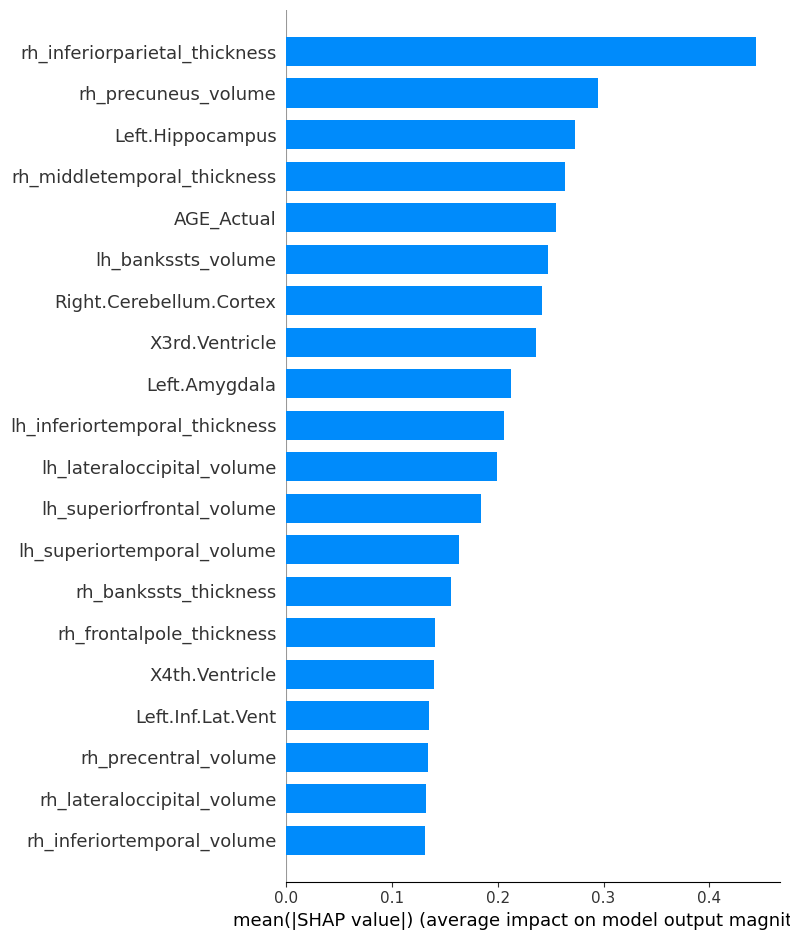

In [ ]:
# Use SHAP to figure out which features contribute most to the classification
optimized_model.fit(X, y) # Train the model before using SHAP
explainer = shap.TreeExplainer(optimized_model)
shap_values = explainer.shap_values(X)

# Plot the SHAP summary plot
shap.summary_plot(shap_values, X, plot_type="bar", show=False)
plt.savefig("shap_summary_plot.png", bbox_inches='tight')
plt.show()